In [100]:
import dask.dataframe as dd
import pandas as pd
import numpy as np
from mpl_toolkits.mplot3d import Axes3D
from matplotlib import pyplot as plt
import seaborn as sns
from sklearn.preprocessing import LabelEncoder
from sklearn.pipeline import Pipeline
import math
from sklearn.decomposition import PCA
from sklearn.model_selection import train_test_split
from sklearn.cluster import KMeans
from sklearn.metrics import classification_report, confusion_matrix, accuracy_score
from sklearn import metrics
from sklearn.preprocessing import StandardScaler, MinMaxScaler, Normalizer
from sklearn.linear_model import LinearRegression
from sklearn.linear_model import LogisticRegression
from sklearn import svm
from sklearn.model_selection import RandomizedSearchCV
import altair
from sklearn.naive_bayes import GaussianNB
from sklearn.tree import DecisionTreeClassifier
import graphviz
from sklearn import tree
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import roc_curve, auc, roc_auc_score
from sklearn.preprocessing import OneHotEncoder

https://www.kaggle.com/aaronschlegel/austin-animal-center-shelter-outcomes-and/data

This is a dataset of cats in an animal shelter in Austin, Texas. The dataset gives details about each cat and what happens to them while at the shelter. There are nine possible outcomes. A cat can be adopted, returned to its owner, transferred to a different shelter, die, be disposed, be euthanized, go missing, receive an RTO-adoption, or have no outcome. Using the given for each cat, it can be predicted what will happen to this cat once it is in the shelter.

## Cleaning the data to use only relevant columns

In [101]:
catdata = pd.read_csv('/home/students/longca04/DS420/aac_shelter_cat_outcome_eng.csv')

In [102]:
originalcatdata = pd.read_csv('/home/students/longca04/DS420/aac_shelter_cat_outcome_eng.csv')

In [103]:
catdata.head()

,age_upon_outcome,animal_id,animal_type,breed,color,date_of_birth,datetime,monthyear,name,outcome_subtype,...,outcome_weekday,outcome_hour,breed1,breed2,cfa_breed,domestic_breed,coat_pattern,color1,color2,coat
0,2 weeks,A684346,Cat,domestic shorthair,orange,2014-07-07 00:00:00,2014-07-22 16:04:00,2014-07-22T16:04:00,NaN,Partner,...,Tuesday,16,domestic shorthair,NaN,False,True,tabby,orange,NaN,orange
1,1 month,A685067,Cat,domestic shorthair,blue /white,2014-06-16 00:00:00,2014-08-14 18:45:00,2014-08-14T18:45:00,Lucy,NaN,...,Thursday,18,domestic shorthair,NaN,False,True,tabby,blue,white,blue
2,3 months,A678580,Cat,domestic shorthair,white/black,2014-03-26 00:00:00,2014-06-29 17:45:00,2014-06-29T17:45:00,*Frida,Offsite,...,Sunday,17,domestic shorthair,NaN,False,True,NaN,white,black,white
3,1 year,A675405,Cat,domestic mediumhair,black/white,2013-03-27 00:00:00,2014-03-28 14:55:00,2014-03-28T14:55:00,Stella Luna,NaN,...,Friday,14,domestic mediumhair,NaN,False,True,NaN,black,white,black
4,3 weeks,A670420,Cat,domestic shorthair,black/white,2013-12-16 00:00:00,2014-01-09 19:29:00,2014-01-09T19:29:00,NaN,Partner,...,Thursday,19,domestic shorthair,NaN,False,True,NaN,black,white,black


In [104]:
catdata = catdata[['outcome_age_(days)','breed','outcome_type','sex_upon_outcome','sex',
                   'Spay/Neuter','breed1','breed2','domestic_breed','coat_pattern','color1','color2']]

In [105]:
catdata.head()

,outcome_age_(days),breed,outcome_type,sex_upon_outcome,sex,Spay/Neuter,breed1,breed2,domestic_breed,coat_pattern,color1,color2
0,14,domestic shorthair,Transfer,Intact Male,Male,No,domestic shorthair,NaN,True,tabby,orange,NaN
1,30,domestic shorthair,Adoption,Intact Female,Female,No,domestic shorthair,NaN,True,tabby,blue,white
2,90,domestic shorthair,Adoption,Spayed Female,Female,Yes,domestic shorthair,NaN,True,NaN,white,black
3,365,domestic mediumhair,Return to Owner,Spayed Female,Female,Yes,domestic mediumhair,NaN,True,NaN,black,white
4,21,domestic shorthair,Transfer,Intact Male,Male,No,domestic shorthair,NaN,True,NaN,black,white


In [106]:
values = {'outcome_type': 'No Outcome', 'coat_pattern': 'No Pattern', 'color2': 'No 2nd Color', 'breed2': 'No 2nd Breed'}

In [107]:
catdata = catdata.fillna(value=values)

In [108]:
catdata.head()

,outcome_age_(days),breed,outcome_type,sex_upon_outcome,sex,Spay/Neuter,breed1,breed2,domestic_breed,coat_pattern,color1,color2
0,14,domestic shorthair,Transfer,Intact Male,Male,No,domestic shorthair,No 2nd Breed,True,tabby,orange,No 2nd Color
1,30,domestic shorthair,Adoption,Intact Female,Female,No,domestic shorthair,No 2nd Breed,True,tabby,blue,white
2,90,domestic shorthair,Adoption,Spayed Female,Female,Yes,domestic shorthair,No 2nd Breed,True,No Pattern,white,black
3,365,domestic mediumhair,Return to Owner,Spayed Female,Female,Yes,domestic mediumhair,No 2nd Breed,True,No Pattern,black,white
4,21,domestic shorthair,Transfer,Intact Male,Male,No,domestic shorthair,No 2nd Breed,True,No Pattern,black,white


In [109]:
alloutcomes = list(catdata.outcome_type)

In [110]:
outcomelist = []
for i in alloutcomes:
    if i not in outcomelist:
        outcomelist.append(i)

In [111]:
outcomelist

['Transfer',
 'Adoption',
 'Return to Owner',
 'Died',
 'Euthanasia',
 'Missing',
 'Disposal',
 'Rto-Adopt',
 'No Outcome']

This is a list of all the possible outcomes of the cats that live in the shelter. The data on each cat will be used to predict what will happen to it.

In [112]:
encodedcatdata = catdata

In [113]:
labelencoder = LabelEncoder()
encodedcatdata['breed'] = labelencoder.fit_transform(encodedcatdata['breed'])
encodedcatdata['outcome_type'] = labelencoder.fit_transform(encodedcatdata['outcome_type'])
encodedcatdata['sex_upon_outcome'] = labelencoder.fit_transform(encodedcatdata['sex_upon_outcome'])
encodedcatdata['sex'] = labelencoder.fit_transform(encodedcatdata['sex'])
encodedcatdata['Spay/Neuter'] = labelencoder.fit_transform(encodedcatdata['Spay/Neuter'])
encodedcatdata['breed1'] = labelencoder.fit_transform(encodedcatdata['breed1'])
encodedcatdata['breed2'] = labelencoder.fit_transform(encodedcatdata['breed2'])
encodedcatdata['domestic_breed'] = labelencoder.fit_transform(encodedcatdata['domestic_breed'])
encodedcatdata['coat_pattern'] = labelencoder.fit_transform(encodedcatdata['coat_pattern'])
encodedcatdata['color1'] = labelencoder.fit_transform(encodedcatdata['color1'])
encodedcatdata['color2'] = labelencoder.fit_transform(encodedcatdata['color2'])

In [114]:
encodedcatdata.head()

,outcome_age_(days),breed,outcome_type,sex_upon_outcome,sex,Spay/Neuter,breed1,breed2,domestic_breed,coat_pattern,color1,color2
0,14,26,8,1,1,0,17,0,1,6,26,0
1,30,26,0,0,0,0,17,0,1,6,6,18
2,90,26,0,3,0,1,17,0,1,0,38,2
3,365,22,6,3,0,1,16,0,1,0,2,18
4,21,26,8,1,1,0,17,0,1,0,2,18


Every column in the dataframe, except outcome_age_(days), was label encoded to give values. Also, the outcome_age_(days) column is the only numeric column. Everything else is categorical.

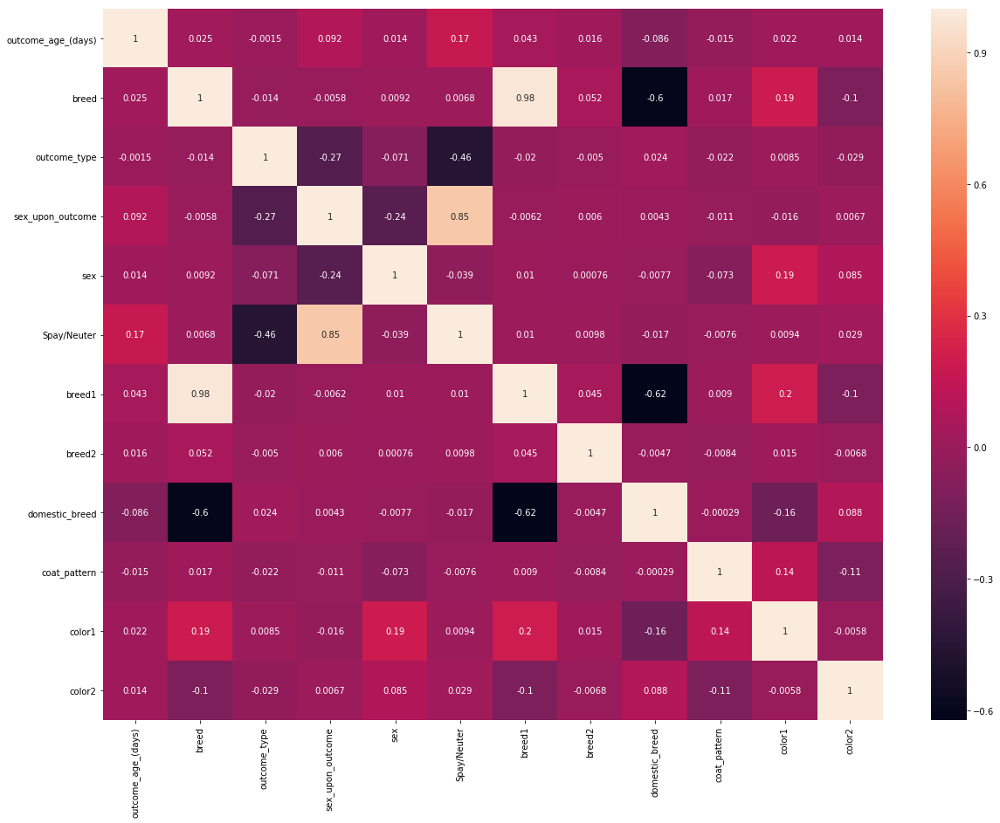

In [115]:
plt.subplots(figsize=(20,15))
sns.heatmap(encodedcatdata.corr(), annot=True)

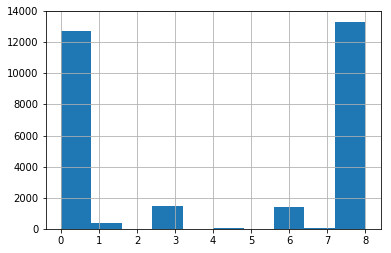

In [116]:
encodedcatdata['outcome_type'].hist()

This is a simple histogram that shows the number of occurances for each particular outcome. Transfer is the most common outcome, followed by adoption. These are the two most common by far. Euthanasia and return to owner are the next two most common occurances. Every outcome does occur, even though it does not appear this way in the histogram.

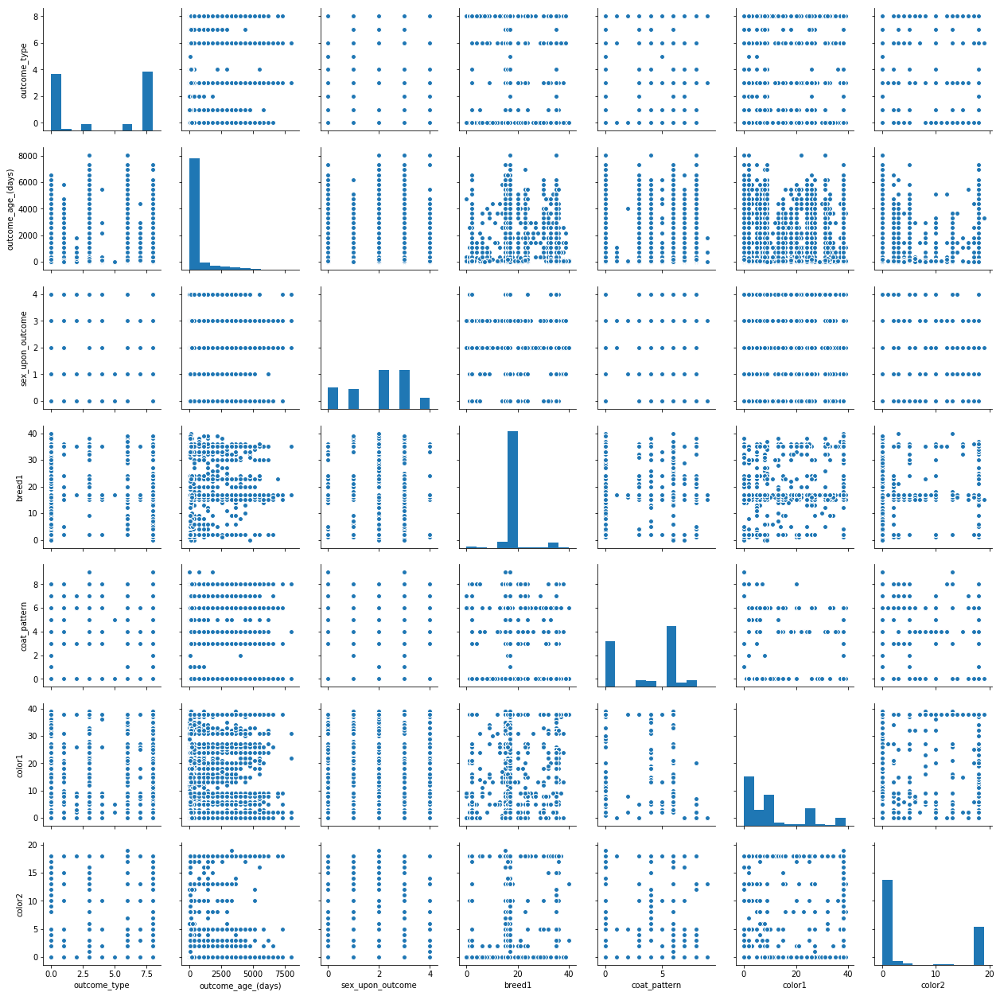

In [117]:
sns.pairplot(encodedcatdata[['outcome_type','outcome_age_(days)','sex_upon_outcome','breed1','coat_pattern','color1','color2']])

In the pairplot of the data, it is difficult to find any correltation because there are so many datapoints. Two relations I did find are that the columns that have a higher age are more likely to have euthanasia or return to owner as the outcome. Also, there seems to be a certain breed of cats that has two colors.

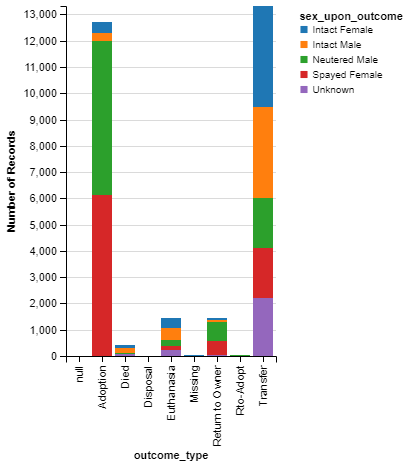

In [118]:
altair.Chart(originalcatdata, max_rows=100000).mark_bar().encode(x='outcome_type',color='sex_upon_outcome',y='count(*)')

This bar chart of the outcomes based on their sex upon outcome shows how that variable affects the outcome. (This was probably the most interesting chart I looked at.) Clearly, the cats that were adopted are much more likely to be neutered or spayed. The cats that were transfered are more likely not to be. It is tougher to see, but the neutered/spayed cats are also more commonly returned to their owner than those that are not.

## Best model with the original data

In [119]:
withoutoutcome = encodedcatdata.drop(columns=['outcome_type'])

In [120]:
outcomes = encodedcatdata[['outcome_type']]

In [121]:
q = np.array(withoutoutcome)

In [122]:
X_train, X_test, y_train, y_test = train_test_split(q,outcomes,test_size=0.2,random_state=4)

#### Random Forest

In [123]:
model_RR = RandomForestClassifier()

In [124]:
model_RR.fit(X_train, y_train)

/usr/local/lib/python3.5/site-packages/ipykernel_launcher.py:1: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  """Entry point for launching an IPython kernel.


RandomForestClassifier(bootstrap=True, class_weight=None, criterion='gini',
            max_depth=None, max_features='auto', max_leaf_nodes=None,
            min_impurity_decrease=0.0, min_impurity_split=None,
            min_samples_leaf=1, min_samples_split=2,
            min_weight_fraction_leaf=0.0, n_estimators=10, n_jobs=1,
            oob_score=False, random_state=None, verbose=0,
            warm_start=False)

In [125]:
predRForiginal = model_RR.predict(X_test)

In [126]:
metrics.accuracy_score(y_test, predRForiginal)

0.7138487680543756

In [127]:
metrics.confusion_matrix(y_test, predRForiginal)

array([[2092,    4,    0,   11,    0,    0,   39,    1,  376],
       [  12,    5,    0,    3,    1,    0,    0,    0,   69],
       [   0,    0,    0,    0,    0,    0,    0,    0,    5],
       [  43,    5,    0,   28,    0,    0,   14,    0,  209],
       [   2,    0,    0,    0,    0,    0,    0,    0,    1],
       [   0,    0,    0,    0,    0,    0,    0,    0,    2],
       [ 154,    0,    0,   10,    0,    0,   24,    0,  108],
       [   5,    0,    0,    0,    0,    0,    0,    0,    0],
       [ 505,   10,    0,   54,    0,    0,   40,    1, 2052]])

In [128]:
print(classification_report(y_test, predRForiginal, target_names=['Adoption','Died','Disposal','Euthanasia','Missing',
                                                                  'No Outcome','Return to Owner','RTO-adopt','Transfer']))

                 precision    recall  f1-score   support

       Adoption       0.74      0.83      0.78      2523
           Died       0.21      0.06      0.09        90
       Disposal       0.00      0.00      0.00         5
     Euthanasia       0.26      0.09      0.14       299
        Missing       0.00      0.00      0.00         3
     No Outcome       0.00      0.00      0.00         2
Return to Owner       0.21      0.08      0.12       296
      RTO-adopt       0.00      0.00      0.00         5
       Transfer       0.73      0.77      0.75      2662

    avg / total       0.67      0.71      0.69      5885



/usr/local/lib/python3.5/site-packages/sklearn/metrics/classification.py:1135: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples.
  'precision', 'predicted', average, warn_for)


The random forest model gave the best prediction when using the original, label encoded data. Without altering anything, it was able to predict the outcome of a cat in the shelter with roughly 71-72% accuracy. The decision tree model produced the second highest accuracy, with about 70-71%. The KMeans model gave about 33.% accuracy. Without looking at the classification report, 71% seems to be a pretty good predictor. However, the classification report shows that this models predicts adoptions and transfers fairly well, but does a horrible job predicting the others. This shows that a transformation might be helpful in order to get a better model.

## Best model with PCA

#### Decision Tree

In [129]:
pca = PCA(n_components=2)
x = pca.fit_transform(withoutoutcome)

In [130]:
X_trainPCA, X_testPCA, y_trainPCA, y_testPCA = train_test_split(x,outcomes,test_size=0.2,random_state=4)

In [131]:
model_tree = DecisionTreeClassifier()

In [132]:
model_tree.fit(X_trainPCA, y_trainPCA)

DecisionTreeClassifier(class_weight=None, criterion='gini', max_depth=None,
            max_features=None, max_leaf_nodes=None,
            min_impurity_decrease=0.0, min_impurity_split=None,
            min_samples_leaf=1, min_samples_split=2,
            min_weight_fraction_leaf=0.0, presort=False, random_state=None,
            splitter='best')

In [133]:
predtreePCA = model_tree.predict(X_testPCA)

In [134]:
metrics.accuracy_score(y_testPCA, predtreePCA)

0.6949872557349193

In [135]:
metrics.confusion_matrix(y_testPCA, predtreePCA)

array([[2070,    4,    0,   35,    0,    0,   44,    0,  370],
       [  19,    5,    0,    1,    0,    0,    0,    0,   65],
       [   1,    0,    1,    0,    0,    0,    0,    0,    3],
       [  66,    5,    0,   30,    0,    0,   21,    0,  177],
       [   2,    0,    0,    0,    0,    0,    0,    0,    1],
       [   0,    0,    0,    0,    0,    0,    0,    0,    2],
       [ 156,    1,    0,   10,    0,    0,   25,    0,  104],
       [   4,    0,    0,    0,    1,    0,    0,    0,    0],
       [ 579,   13,    0,   68,    1,    0,   42,    0, 1959]])

In [136]:
print(classification_report(y_testPCA, predtreePCA, target_names=['Adoption','Died','Disposal','Euthanasia','Missing',
                                                                  'No Outcome','Return to Owner','RTO-adopt','Transfer']))

                 precision    recall  f1-score   support

       Adoption       0.71      0.82      0.76      2523
           Died       0.18      0.06      0.08        90
       Disposal       1.00      0.20      0.33         5
     Euthanasia       0.21      0.10      0.14       299
        Missing       0.00      0.00      0.00         3
     No Outcome       0.00      0.00      0.00         2
Return to Owner       0.19      0.08      0.12       296
      RTO-adopt       0.00      0.00      0.00         5
       Transfer       0.73      0.74      0.73      2662

    avg / total       0.66      0.69      0.67      5885



/usr/local/lib/python3.5/site-packages/sklearn/metrics/classification.py:1135: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples.
  'precision', 'predicted', average, warn_for)


The decision tree model gave the best prediction after a PCA transformation on the predictor columns of the data. The transformation actually caused this model to give a slightly worse prediction than before, at roughly 69 or 70%. Random forest was the second best model with 69% accuracy. The third best model was Gaussian Naive Bayes. This model was most greatly affected by the PCA transformation, improving from about 14% to 45%. All in all, the PCA transformation did not do much. The precision for adoption and transfer are still much higher than the others. However, the precision for disposal increased from 0 to 50%. Still, the PCA did not help because the best model gave a worse prediction than the best model for the non-transformed data.

## Best models after the one hot encoded data

In order to obtain better results than these, the data was one hot encoded. The outcome_type column was not one hot encoded because that is what the model is trying to predict. The outcome_age_(days) column has numeric data, so that was not one hot encoded. Every other column is categorical, so it can undergo this transformation.

In [137]:
numericaldata = encodedcatdata[['outcome_age_(days)','outcome_type']]

In [138]:
categoricaldata = encodedcatdata[['breed','sex_upon_outcome','sex','Spay/Neuter','breed1','breed2','domestic_breed',
                                 'coat_pattern','color1','color2']]

In [139]:
onehot_encoder = OneHotEncoder(sparse=False)

In [140]:
onehoted = onehot_encoder.fit_transform(categoricaldata)

In [141]:
onehoted = pd.DataFrame(onehoted)

In [142]:
onehotdata = numericaldata.join(onehoted)

In [143]:
onehotdata.head()

,outcome_age_(days),outcome_type,0,1,2,3,4,5,6,7,...,192,193,194,195,196,197,198,199,200,201
0,14,8,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,30,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0
2,90,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,365,6,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0
4,21,8,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0


In [144]:
u = np.array(onehotdata)

In [145]:
X_train1hot, X_test1hot, y_train1hot, y_test1hot = train_test_split(u,outcomes,test_size=0.2,random_state=4)

## 3 Best Models (Linear Regression, Support Vector Machines, and Decision Tree)

### Linear Regression

In [146]:
lr = LinearRegression()

In [147]:
lr.fit(X_test1hot,y_test1hot)

LinearRegression(copy_X=True, fit_intercept=True, n_jobs=1, normalize=False)

In [148]:
ypred1hot = lr.predict(X_test1hot)

In [149]:
yp1hot = []
for i in ypred1hot:
    yp1hot.append(int(round(i[0])))

In [150]:
metrics.accuracy_score(y_test1hot,yp1hot)

1.0

In [151]:
metrics.confusion_matrix(y_test1hot,yp1hot)

array([[2523,    0,    0,    0,    0,    0,    0,    0,    0],
       [   0,   90,    0,    0,    0,    0,    0,    0,    0],
       [   0,    0,    5,    0,    0,    0,    0,    0,    0],
       [   0,    0,    0,  299,    0,    0,    0,    0,    0],
       [   0,    0,    0,    0,    3,    0,    0,    0,    0],
       [   0,    0,    0,    0,    0,    2,    0,    0,    0],
       [   0,    0,    0,    0,    0,    0,  296,    0,    0],
       [   0,    0,    0,    0,    0,    0,    0,    5,    0],
       [   0,    0,    0,    0,    0,    0,    0,    0, 2662]])

In [152]:
print(classification_report(y_test1hot, yp1hot, target_names=['Adoption','Died','Disposal','Euthanasia','Missing',
                                                                  'No Outcome','Return to Owner','RTO-adopt','Transfer']))

                 precision    recall  f1-score   support

       Adoption       1.00      1.00      1.00      2523
           Died       1.00      1.00      1.00        90
       Disposal       1.00      1.00      1.00         5
     Euthanasia       1.00      1.00      1.00       299
        Missing       1.00      1.00      1.00         3
     No Outcome       1.00      1.00      1.00         2
Return to Owner       1.00      1.00      1.00       296
      RTO-adopt       1.00      1.00      1.00         5
       Transfer       1.00      1.00      1.00      2662

    avg / total       1.00      1.00      1.00      5885



### Support Vector Machines

In [153]:
clf = svm.SVR()
clf.fit(y_test1hot,yp1hot)

SVR(C=1.0, cache_size=200, coef0=0.0, degree=3, epsilon=0.1, gamma='auto',
  kernel='rbf', max_iter=-1, shrinking=True, tol=0.001, verbose=False)

In [154]:
svm_y_pred = clf.predict(y_test1hot)

In [155]:
yp21hot = []
for i in svm_y_pred:
    yp21hot.append(int(round(i)))

In [156]:
metrics.accuracy_score(y_test1hot,yp21hot)

1.0

In [157]:
metrics.confusion_matrix(y_test1hot,yp21hot)

array([[2523,    0,    0,    0,    0,    0,    0,    0,    0],
       [   0,   90,    0,    0,    0,    0,    0,    0,    0],
       [   0,    0,    5,    0,    0,    0,    0,    0,    0],
       [   0,    0,    0,  299,    0,    0,    0,    0,    0],
       [   0,    0,    0,    0,    3,    0,    0,    0,    0],
       [   0,    0,    0,    0,    0,    2,    0,    0,    0],
       [   0,    0,    0,    0,    0,    0,  296,    0,    0],
       [   0,    0,    0,    0,    0,    0,    0,    5,    0],
       [   0,    0,    0,    0,    0,    0,    0,    0, 2662]])

In [158]:
print(classification_report(y_test1hot, yp21hot, target_names=['Adoption','Died','Disposal','Euthanasia','Missing',
                                                                  'No Outcome','Return to Owner','RTO-adopt','Transfer']))

                 precision    recall  f1-score   support

       Adoption       1.00      1.00      1.00      2523
           Died       1.00      1.00      1.00        90
       Disposal       1.00      1.00      1.00         5
     Euthanasia       1.00      1.00      1.00       299
        Missing       1.00      1.00      1.00         3
     No Outcome       1.00      1.00      1.00         2
Return to Owner       1.00      1.00      1.00       296
      RTO-adopt       1.00      1.00      1.00         5
       Transfer       1.00      1.00      1.00      2662

    avg / total       1.00      1.00      1.00      5885



### Decision Tree

In [159]:
model_tree.fit(X_train1hot, y_train1hot)

DecisionTreeClassifier(class_weight=None, criterion='gini', max_depth=None,
            max_features=None, max_leaf_nodes=None,
            min_impurity_decrease=0.0, min_impurity_split=None,
            min_samples_leaf=1, min_samples_split=2,
            min_weight_fraction_leaf=0.0, presort=False, random_state=None,
            splitter='best')

In [160]:
predtree1hot = model_tree.predict(X_test1hot)

In [161]:
metrics.accuracy_score(y_test1hot, predtree1hot)

1.0

In [162]:
metrics.confusion_matrix(y_test1hot, predtree1hot)

array([[2523,    0,    0,    0,    0,    0,    0,    0,    0],
       [   0,   90,    0,    0,    0,    0,    0,    0,    0],
       [   0,    0,    5,    0,    0,    0,    0,    0,    0],
       [   0,    0,    0,  299,    0,    0,    0,    0,    0],
       [   0,    0,    0,    0,    3,    0,    0,    0,    0],
       [   0,    0,    0,    0,    0,    2,    0,    0,    0],
       [   0,    0,    0,    0,    0,    0,  296,    0,    0],
       [   0,    0,    0,    0,    0,    0,    0,    5,    0],
       [   0,    0,    0,    0,    0,    0,    0,    0, 2662]])

## 2 Models that are not 100%, but are still very good

### GaussianNB

In [163]:
model_naive = GaussianNB()

In [164]:
model_naive.fit(X_train1hot,y_train1hot)

/usr/local/lib/python3.5/site-packages/sklearn/utils/validation.py:578: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


GaussianNB(priors=None)

In [165]:
predNB1hot = model_naive.predict(X_test1hot)

In [166]:
metrics.accuracy_score(y_test1hot, predNB1hot)

0.9988105352591334

In [167]:
metrics.confusion_matrix(y_test1hot, predNB1hot)

array([[2523,    0,    0,    0,    0,    0,    0,    0,    0],
       [   1,   89,    0,    0,    0,    0,    0,    0,    0],
       [   0,    1,    4,    0,    0,    0,    0,    0,    0],
       [   0,    0,    0,  299,    0,    0,    0,    0,    0],
       [   0,    0,    0,    0,    3,    0,    0,    0,    0],
       [   0,    0,    0,    0,    1,    0,    1,    0,    0],
       [   0,    0,    0,    0,    0,    0,  296,    0,    0],
       [   0,    0,    0,    0,    0,    0,    2,    2,    1],
       [   0,    0,    0,    0,    0,    0,    0,    0, 2662]])

In [168]:
print(classification_report(y_test1hot, predNB1hot, target_names=['Adoption','Died','Disposal','Euthanasia','Missing',
                                                                  'No Outcome','Return to Owner','RTO-adopt','Transfer']))

                 precision    recall  f1-score   support

       Adoption       1.00      1.00      1.00      2523
           Died       0.99      0.99      0.99        90
       Disposal       1.00      0.80      0.89         5
     Euthanasia       1.00      1.00      1.00       299
        Missing       0.75      1.00      0.86         3
     No Outcome       0.00      0.00      0.00         2
Return to Owner       0.99      1.00      0.99       296
      RTO-adopt       1.00      0.40      0.57         5
       Transfer       1.00      1.00      1.00      2662

    avg / total       1.00      1.00      1.00      5885



/usr/local/lib/python3.5/site-packages/sklearn/metrics/classification.py:1135: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples.
  'precision', 'predicted', average, warn_for)


### Random Forest

In [169]:
model_RR.fit(X_train1hot, y_train1hot)

/usr/local/lib/python3.5/site-packages/ipykernel_launcher.py:1: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  """Entry point for launching an IPython kernel.


RandomForestClassifier(bootstrap=True, class_weight=None, criterion='gini',
            max_depth=None, max_features='auto', max_leaf_nodes=None,
            min_impurity_decrease=0.0, min_impurity_split=None,
            min_samples_leaf=1, min_samples_split=2,
            min_weight_fraction_leaf=0.0, n_estimators=10, n_jobs=1,
            oob_score=False, random_state=None, verbose=0,
            warm_start=False)

In [170]:
predRF1hot = model_RR.predict(X_test1hot)

In [171]:
metrics.accuracy_score(y_test1hot, predRF1hot)

0.9797790994052676

In [172]:
metrics.confusion_matrix(y_test1hot, predRF1hot)

array([[2519,    3,    0,    1,    0,    0,    0,    0,    0],
       [  13,   65,    0,   11,    0,    0,    0,    0,    1],
       [   0,    0,    1,    3,    0,    0,    0,    0,    1],
       [  10,   13,    0,  258,    2,    0,   14,    0,    2],
       [   0,    0,    0,    1,    0,    0,    2,    0,    0],
       [   1,    0,    0,    1,    0,    0,    0,    0,    0],
       [   3,    0,    0,   19,    0,    0,  266,    1,    7],
       [   0,    0,    0,    0,    0,    0,    4,    0,    1],
       [   1,    0,    0,    0,    0,    0,    4,    0, 2657]])

In [173]:
print(classification_report(y_test1hot, predRF1hot, target_names=['Adoption','Died','Disposal','Euthanasia','Missing',
                                                                  'No Outcome','Return to Owner','RTO-adopt','Transfer']))

                 precision    recall  f1-score   support

       Adoption       0.99      1.00      0.99      2523
           Died       0.80      0.72      0.76        90
       Disposal       1.00      0.20      0.33         5
     Euthanasia       0.88      0.86      0.87       299
        Missing       0.00      0.00      0.00         3
     No Outcome       0.00      0.00      0.00         2
Return to Owner       0.92      0.90      0.91       296
      RTO-adopt       0.00      0.00      0.00         5
       Transfer       1.00      1.00      1.00      2662

    avg / total       0.98      0.98      0.98      5885



/usr/local/lib/python3.5/site-packages/sklearn/metrics/classification.py:1135: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples.
  'precision', 'predicted', average, warn_for)


After one hot encoding the data, each model became extremely accurate except for KMeans which remained around 34% accuracy. Random forest predicted the outcome with roughly 97.9% accuracy and Gaussian Naive Bayes had 99.88% accuracy. Surprisingly, linear regression, support vector machines, and decision tree predicted the outcome of a sheltered cat with 100% accuracy. In the random forest model, the two highest precisions were still adoption and transfer. The others were still not quite as good, but some got much better. The return to owner, euthanasia, and died outcomes all improved greatly. The columns with low precision are so low because there are so little cats that belong to those columns. Therefore, it is not worthwhile to predict a cat will fall into those categories (unless the model has 100% accuracy).

In [174]:
onehotcorrelation = onehotdata.corr()

In [175]:
#onehotcorrelation.to_csv('onehotcatcorrelation.csv')

Lastly, I created a dataframe in order to look at the correlation of the one hot encoded data. There were a few variables that had higher correlations with the outcome than others, but there was not one that was so correlated that it had to be removed. Because of this, no tests need to redone and the 100% accuracy score for the linear regression, support vector machines, and decision tree models will be accepted.